In [2]:

import torch
import os
import numpy as np
from sklearn.cluster import KMeans
from msclap import CLAP
    

os.environ["CUDA_VISIBLE_DEVICES"] = "2"
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
clap_model = CLAP(version = '2023', use_cuda=True)

#import laion_clap
#model = laion_clap.CLAP_Module(enable_fusion=False, amodel= 'HTSAT-base')
#model.load_ckpt('/data5/eloi/checkpoints/laion_clap/music_audioset_epoch_15_esc_90.14.patched.pt')

import sys
import os

sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '..')))

from evaluation.feature_extractors import load_MERT

import omegaconf
mert_args={
    "layer": 9,
    "average": True, #if True, the features will be averaged over time
    "normalize": True
}
mert_args=omegaconf.OmegaConf.create(mert_args)

device= torch.device("cuda" if torch.cuda.is_available() else "cpu")

mert_model=load_MERT(mert_args, device)


In [ ]:
import os
import einops
import torch
import torchaudio
import soundfile as sf
from glob import glob
import tqdm

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

path_TM="/data5/eloi/TencyMastering"
subdirs=["part1","part2", "part3", "part4", "part4_test", "part4_validation"]

path_output="/data5/eloi/TencyMastering/MSCLAP_emb_selected_2"
#path_output="/data5/eloi/TencyMastering/CLAP_emb_selected"
#path_output="/data5/eloi/TencyMastering/MERT_emb_selected"

mix_filenames= ["nbv-bv-ld-nomasterfx_dry.wav", "nbv-bv-ld-NoMasterFx_dry.wav", "nbv-ld-nomasterfx_dry.wav", "nbv-ld-NoMasterFx_dry.wav","nbv-bv-nomasterfx_dry.wav", "nbv-nomasterfx_dry.wav"]

skip_ids = ["6699", "33787", "65486", "66235", "67570", "67808", "12212", "67437", "67476", "67658", "67719", "10356"]

do_selection=True

for subdir in subdirs:
    path=os.path.join(path_TM, subdir)

    #Iterate over each subdirectory
    ids = glob(os.path.join(path,  "*"))

    for id in tqdm.tqdm(ids):
        if os.path.basename(id) in skip_ids:
            print(f"Skipping {id} because it is in the skip list")
            continue

        path_mix=os.path.join(id, "mix")

        if do_selection:
            path_multi=os.path.join(id, "multi")

            files= glob(os.path.join(path_multi, "*.wav"))
            #get first 2 characters of the filenames
            file_taxonomy = [os.path.basename(f)[:2] for f in files]

            if not "11" in file_taxonomy:
                print(f"Skipping {id} because it does not contain a drums or percussion file")
                continue

            if not "21" in file_taxonomy and not "22" in file_taxonomy and not "23" in file_taxonomy:
                print(f"Skipping {id} because it does not contain a bass file")
                continue

            if not "92" in file_taxonomy:
                print(f"Skipping {id} because it does not contain a vocals file")
                continue


        for filename in mix_filenames:
            if os.path.exists(os.path.join(path_mix, filename)):
                mix_file = os.path.join(path_mix, filename)
                break
        
        

        # Load audio
        x, sr= sf.read(mix_file, dtype='float32')

        x=torch.from_numpy(x).unsqueeze(0).to(device).permute(0, 2, 1)  # Convert to (batch_size, channels, samples)


        #stereo to mono if needed
        if x.shape[1] == 2:
            x = x.mean(dim=1, keepdim=True)

        if sr!= clap_model.args.sampling_rate:
            x= torchaudio.functional.resample(x, orig_freq=sr, new_freq=clap_model.args.sampling_rate)


        #print("x shape", x.shape)
        #split into 480000 samples non-overlapping chunks

        chunk_size = clap_model.args.duration*clap_model.args.sampling_rate  # 10 seconds at 48kHz

        chunks = x.unfold(2, chunk_size, chunk_size)
        #print(f"Chunks shape before rearranging: {chunks.shape}")

        chunks=einops.rearrange(chunks, 'b c t s -> (b t) c s')

        chunks= chunks.squeeze(1)

        with torch.no_grad():
            #embs=model.get_audio_embedding_from_data(chunks, use_tensor=True)
            #embs=mert_model(chunks)
            #print(chunks.shape)
            embs=clap_model.clap.audio_encoder(chunks)[0]
        
        #take the mean of the embeddings
        #print("embs shape", embs.shape)
        embs = torch.mean(embs, dim=0, keepdim=False)

        #l2 normalize the embeddings
        embs = torch.nn.functional.normalize(embs, p=2, dim=-1)

        embs=embs.cpu().numpy()

        #save the embeddings in a numpy file
        id_name = os.path.basename(id)

        output_dir = os.path.join(path_output, f"{id_name}.npy")

        np.save(output_dir, embs)


  0%|          | 0/158 [00:00<?, ?it/s]

Skipping /data5/eloi/TencyMastering/part1/9770 because it does not contain a drums or percussion file


  3%|▎         | 4/158 [00:02<02:05,  1.23it/s]

Skipping /data5/eloi/TencyMastering/part1/66656 because it does not contain a bass file


  4%|▍         | 6/158 [00:04<02:12,  1.14it/s]

Skipping /data5/eloi/TencyMastering/part1/6699 because it is in the skip list


 11%|█▏        | 18/158 [00:27<05:54,  2.53s/it]

Skipping /data5/eloi/TencyMastering/part1/28208 because it does not contain a drums or percussion file


 20%|█▉        | 31/158 [01:01<05:39,  2.68s/it]

Skipping /data5/eloi/TencyMastering/part1/45403 because it does not contain a drums or percussion file


 21%|██        | 33/158 [01:02<03:51,  1.85s/it]

Skipping /data5/eloi/TencyMastering/part1/26490 because it does not contain a drums or percussion file


 23%|██▎       | 36/158 [01:07<03:41,  1.81s/it]

Skipping /data5/eloi/TencyMastering/part1/66685 because it does not contain a drums or percussion file


 45%|████▍     | 71/158 [02:09<02:48,  1.93s/it]

Skipping /data5/eloi/TencyMastering/part1/15672 because it does not contain a drums or percussion file


 46%|████▌     | 73/158 [02:11<02:05,  1.48s/it]

Skipping /data5/eloi/TencyMastering/part1/66393 because it does not contain a drums or percussion file


 47%|████▋     | 75/158 [02:13<01:47,  1.29s/it]

Skipping /data5/eloi/TencyMastering/part1/66538 because it does not contain a drums or percussion file
Skipping /data5/eloi/TencyMastering/part1/28449 because it does not contain a drums or percussion file


 52%|█████▏    | 82/158 [02:22<01:55,  1.52s/it]

Skipping /data5/eloi/TencyMastering/part1/66560 because it does not contain a drums or percussion file


 57%|█████▋    | 90/158 [02:33<01:44,  1.53s/it]

Skipping /data5/eloi/TencyMastering/part1/66235 because it is in the skip list


 60%|██████    | 95/158 [02:40<01:36,  1.53s/it]

Skipping /data5/eloi/TencyMastering/part1/66612 because it does not contain a bass file


 63%|██████▎   | 100/158 [02:47<01:26,  1.50s/it]

Skipping /data5/eloi/TencyMastering/part1/33787 because it is in the skip list


 67%|██████▋   | 106/158 [02:55<01:22,  1.60s/it]

Skipping /data5/eloi/TencyMastering/part1/66276 because it does not contain a drums or percussion file


 70%|███████   | 111/158 [03:01<01:01,  1.31s/it]

Skipping /data5/eloi/TencyMastering/part1/66528 because it does not contain a drums or percussion file


 80%|████████  | 127/158 [03:18<00:33,  1.08s/it]

Skipping /data5/eloi/TencyMastering/part1/66534 because it does not contain a drums or percussion file
Skipping /data5/eloi/TencyMastering/part1/66652 because it does not contain a drums or percussion file


 84%|████████▍ | 133/158 [03:22<00:22,  1.09it/s]

Skipping /data5/eloi/TencyMastering/part1/33251 because it does not contain a drums or percussion file


 92%|█████████▏| 145/158 [03:29<00:06,  2.08it/s]

Skipping /data5/eloi/TencyMastering/part1/66444 because it does not contain a drums or percussion file


 95%|█████████▍| 150/158 [03:30<00:02,  3.00it/s]

Skipping /data5/eloi/TencyMastering/part1/65486 because it is in the skip list
Skipping /data5/eloi/TencyMastering/part1/66503 because it does not contain a drums or percussion file


  2%|▏         | 7/311 [00:01<01:00,  5.02it/s]

Skipping /data5/eloi/TencyMastering/part2/67067 because it does not contain a bass file


  3%|▎         | 10/311 [00:02<01:13,  4.08it/s]

Skipping /data5/eloi/TencyMastering/part2/67265 because it does not contain a bass file


 12%|█▏        | 38/311 [00:15<04:42,  1.03s/it]

Skipping /data5/eloi/TencyMastering/part2/67719 because it is in the skip list


 18%|█▊        | 55/311 [00:36<07:11,  1.69s/it]

Skipping /data5/eloi/TencyMastering/part2/67439 because it does not contain a drums or percussion file


 19%|█▉        | 60/311 [00:43<06:54,  1.65s/it]

Skipping /data5/eloi/TencyMastering/part2/67369 because it does not contain a drums or percussion file


 21%|██        | 65/311 [00:50<06:37,  1.62s/it]

Skipping /data5/eloi/TencyMastering/part2/67447 because it does not contain a drums or percussion file


 22%|██▏       | 69/311 [00:55<05:52,  1.46s/it]

Skipping /data5/eloi/TencyMastering/part2/67809 because it does not contain a drums or percussion file


 25%|██▍       | 77/311 [01:10<08:06,  2.08s/it]

Skipping /data5/eloi/TencyMastering/part2/67897 because it does not contain a bass file


 27%|██▋       | 85/311 [01:25<07:26,  1.98s/it]

Skipping /data5/eloi/TencyMastering/part2/66928 because it does not contain a drums or percussion file


 31%|███       | 95/311 [01:55<10:21,  2.88s/it]

Skipping /data5/eloi/TencyMastering/part2/67403 because it does not contain a drums or percussion file


 31%|███       | 97/311 [01:57<07:32,  2.12s/it]

Skipping /data5/eloi/TencyMastering/part2/67615 because it does not contain a drums or percussion file


 33%|███▎      | 102/311 [02:10<09:01,  2.59s/it]

Skipping /data5/eloi/TencyMastering/part2/67253 because it does not contain a drums or percussion file


 36%|███▋      | 113/311 [02:34<08:16,  2.51s/it]

Skipping /data5/eloi/TencyMastering/part2/67330 because it does not contain a drums or percussion file


 44%|████▍     | 137/311 [03:34<09:08,  3.15s/it]

Skipping /data5/eloi/TencyMastering/part2/67306 because it does not contain a drums or percussion file


 46%|████▌     | 143/311 [03:45<06:11,  2.21s/it]

Skipping /data5/eloi/TencyMastering/part2/67525 because it does not contain a drums or percussion file


 48%|████▊     | 148/311 [03:56<06:13,  2.29s/it]

Skipping /data5/eloi/TencyMastering/part2/67011 because it does not contain a drums or percussion file


 49%|████▊     | 151/311 [04:01<05:12,  1.95s/it]

Skipping /data5/eloi/TencyMastering/part2/68104 because it does not contain a drums or percussion file
Skipping /data5/eloi/TencyMastering/part2/67523 because it does not contain a drums or percussion file


 50%|████▉     | 155/311 [04:05<03:52,  1.49s/it]

Skipping /data5/eloi/TencyMastering/part2/67056 because it does not contain a drums or percussion file


 50%|█████     | 157/311 [04:08<03:35,  1.40s/it]

Skipping /data5/eloi/TencyMastering/part2/67740 because it does not contain a drums or percussion file
Skipping /data5/eloi/TencyMastering/part2/67775 because it does not contain a drums or percussion file
Skipping /data5/eloi/TencyMastering/part2/67658 because it is in the skip list
Skipping /data5/eloi/TencyMastering/part2/67616 because it does not contain a drums or percussion file


 56%|█████▌    | 173/311 [04:47<08:27,  3.68s/it]

Skipping /data5/eloi/TencyMastering/part2/67783 because it does not contain a drums or percussion file


 59%|█████▉    | 185/311 [05:27<07:56,  3.78s/it]

Skipping /data5/eloi/TencyMastering/part2/67377 because it does not contain a drums or percussion file


 64%|██████▎   | 198/311 [06:01<05:17,  2.81s/it]

Skipping /data5/eloi/TencyMastering/part2/67186 because it does not contain a drums or percussion file


 74%|███████▎  | 229/311 [07:20<03:38,  2.66s/it]

Skipping /data5/eloi/TencyMastering/part2/67412 because it does not contain a drums or percussion file


 78%|███████▊  | 243/311 [07:59<03:14,  2.87s/it]

Skipping /data5/eloi/TencyMastering/part2/67812 because it does not contain a drums or percussion file


 84%|████████▎ | 260/311 [08:38<02:11,  2.57s/it]

Skipping /data5/eloi/TencyMastering/part2/67022 because it does not contain a drums or percussion file


 86%|████████▌ | 266/311 [08:56<02:43,  3.62s/it]

Skipping /data5/eloi/TencyMastering/part2/67532 because it does not contain a drums or percussion file


 86%|████████▋ | 269/311 [09:04<02:18,  3.31s/it]

Skipping /data5/eloi/TencyMastering/part2/67001 because it does not contain a drums or percussion file


 87%|████████▋ | 271/311 [09:07<01:41,  2.54s/it]

Skipping /data5/eloi/TencyMastering/part2/68038 because it does not contain a drums or percussion file
Skipping /data5/eloi/TencyMastering/part2/67808 because it is in the skip list


 92%|█████████▏| 285/311 [09:38<01:22,  3.18s/it]

Skipping /data5/eloi/TencyMastering/part2/66717 because it does not contain a vocals file


 93%|█████████▎| 288/311 [09:44<00:59,  2.61s/it]

Skipping /data5/eloi/TencyMastering/part2/66794 because it does not contain a drums or percussion file


 98%|█████████▊| 304/311 [10:26<00:20,  2.98s/it]

Skipping /data5/eloi/TencyMastering/part2/67326 because it does not contain a drums or percussion file


 98%|█████████▊| 306/311 [10:29<00:10,  2.10s/it]

Skipping /data5/eloi/TencyMastering/part2/67570 because it is in the skip list


 25%|██▌       | 18/71 [00:41<02:13,  2.52s/it]

Skipping /data5/eloi/TencyMastering/part3/67459 because it does not contain a drums or percussion file


 30%|██▉       | 21/71 [00:46<01:43,  2.07s/it]

Skipping /data5/eloi/TencyMastering/part3/66604 because it does not contain a drums or percussion file


 38%|███▊      | 27/71 [01:02<01:56,  2.64s/it]

Skipping /data5/eloi/TencyMastering/part3/66544 because it does not contain a drums or percussion file


 48%|████▊     | 34/71 [01:15<01:16,  2.08s/it]

Skipping /data5/eloi/TencyMastering/part3/66246 because it does not contain a drums or percussion file


 55%|█████▍    | 39/71 [01:25<01:14,  2.34s/it]

Skipping /data5/eloi/TencyMastering/part3/67437 because it is in the skip list


 59%|█████▉    | 42/71 [01:29<00:54,  1.89s/it]

Skipping /data5/eloi/TencyMastering/part3/67568 because it does not contain a drums or percussion file


 72%|███████▏  | 51/71 [01:46<00:43,  2.20s/it]

Skipping /data5/eloi/TencyMastering/part3/67503 because it does not contain a drums or percussion file


 83%|████████▎ | 59/71 [02:02<00:26,  2.19s/it]

Skipping /data5/eloi/TencyMastering/part3/66695 because it does not contain a drums or percussion file


 93%|█████████▎| 66/71 [02:15<00:09,  1.90s/it]

Skipping /data5/eloi/TencyMastering/part3/12212 because it is in the skip list


 96%|█████████▌| 68/71 [02:17<00:04,  1.53s/it]

Skipping /data5/eloi/TencyMastering/part3/67321 because it does not contain a drums or percussion file


100%|██████████| 71/71 [02:20<00:00,  1.98s/it]
0it [00:00, ?it/s]
  7%|▋         | 2/30 [00:03<00:43,  1.54s/it]

Skipping /data5/eloi/TencyMastering/part4_test/67580 because it does not contain a vocals file


 53%|█████▎    | 16/30 [00:34<00:40,  2.87s/it]

Skipping /data5/eloi/TencyMastering/part4_test/21496 because it does not contain a drums or percussion file


  0%|          | 0/30 [00:00<?, ?it/s]

Skipping /data5/eloi/TencyMastering/part4_validation/10356 because it is in the skip list


 10%|█         | 3/30 [00:05<00:47,  1.75s/it]

Skipping /data5/eloi/TencyMastering/part4_validation/49742 because it does not contain a drums or percussion file


 80%|████████  | 24/30 [00:50<00:13,  2.19s/it]

Skipping /data5/eloi/TencyMastering/part4_validation/67476 because it is in the skip list


100%|██████████| 30/30 [01:01<00:00,  2.04s/it]


Loading embeddings: 100%|██████████| 525/525 [00:04<00:00, 106.85it/s]


Number of borderline points: 158

Number of points per cluster:
Cluster 0: 182 points
Cluster 1: 185 points
Cluster 2: 158 points


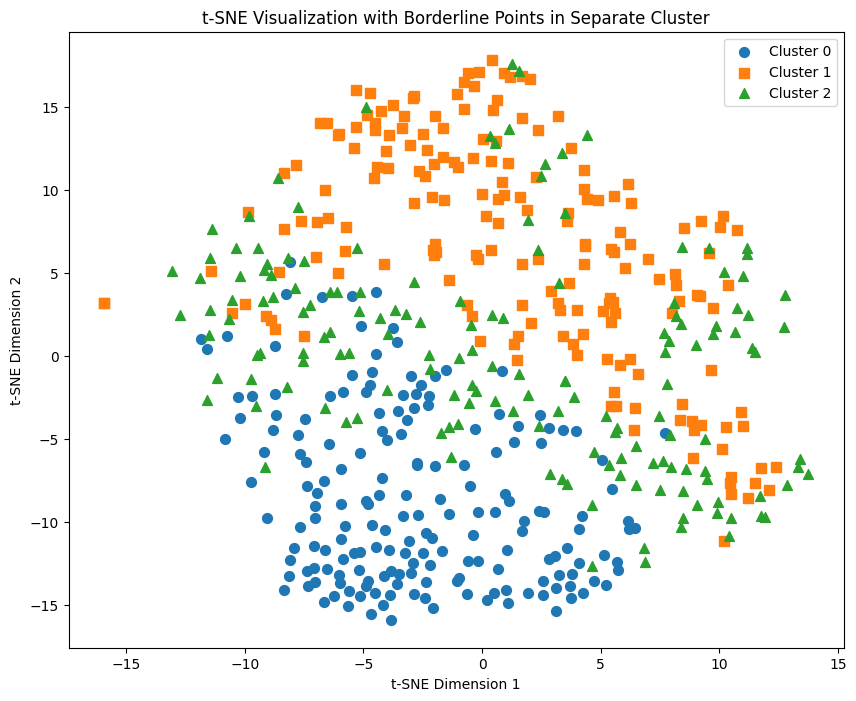

In [8]:
import os
import glob
import tqdm
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from collections import Counter
from k_means_constrained import KMeansConstrained
from sklearn.metrics import pairwise_distances_argmin_min
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import pairwise_distances

# Path to the directory containing the .npy embedding files
path_embeddings = "/data5/eloi/TencyMastering/MSCLAP_emb_selected_2"

# Dictionary to store embeddings
embeddings = {}

# Load all .npy embedding files
embeddings_files = glob.glob(os.path.join(path_embeddings, "*.npy"))

for embs_file in tqdm.tqdm(embeddings_files, desc="Loading embeddings"):
    id_name = os.path.basename(embs_file).replace(".npy", "")  # Extract file ID
    embs = np.load(embs_file)  # Load the embedding
    embeddings[id_name] = embs



# Combine all embeddings into a single array for clustering
track_ids = list(embeddings.keys())  # List of track IDs
all_embeddings = np.array([embeddings[track_id] for track_id in track_ids])  # Stack embeddings

# Optional: Re-normalize embeddings if they were aggregated and lost L2 normalization
def l2_normalize(embedding):
    return embedding / np.linalg.norm(embedding)

all_embeddings = np.array([l2_normalize(emb) for emb in all_embeddings])

# Perform KMeans clustering
n_clusters =2  # Number of clusters
#kmeans = KMeans(n_clusters=n_clusters, random_state=42)
#kmeans = KMeans(n_clusters=n_clusters, max_iter=10000,  random_state=40, init='k-means++')
#clusters = kmeans.fit_predict(all_embeddings)
max_cluster_size = (len(all_embeddings) // n_clusters )+1  # Maximum size per cluster
min_cluster_size = (len(all_embeddings) // n_clusters )  # Minimum size per cluster


kmeans_balanced = KMeansConstrained(
    n_clusters=n_clusters,
    size_min=min_cluster_size,  # No minimum size constraint
    size_max=max_cluster_size,  # Maximum size per cluster
    random_state=42
)

#kmeans_balanced = KMeans(
#    n_clusters=n_clusters,
#    random_state=42
#)

clusters = kmeans_balanced.fit_predict(all_embeddings)

#cluster_centers = kmeans_balanced.cluster_centers_
#distances_to_centroids = pairwise_distances(all_embeddings, cluster_centers)
#similarity_to_centroids = cosine_similarity(all_embeddings, cluster_centers)
#distances_to_centroids = 1 - similarity_to_centroids

len_ = np.sqrt(np.square(kmeans_balanced.cluster_centers_).sum(axis=1)[:,None])
centers = kmeans_balanced.cluster_centers_ / len_
distances_to_centroids = 1 - np.dot(centers, all_embeddings.T) # K x N matrix of cosine distances
distances_to_centroids = distances_to_centroids.T  # Transpose to have shape (N, K) where N is number of embeddings and K is number of clusters

# Identify assigned and neighboring centroids
assigned_centroids = np.argmin(distances_to_centroids, axis=1)  # Index of assigned centroid
neighboring_distances = np.partition(distances_to_centroids, 1, axis=1)[:, 1]  # Distance to nearest neighboring centroid
assigned_distances = distances_to_centroids[np.arange(len(all_embeddings)), assigned_centroids]  # Distance to assigned centroid

# Define borderline points based on distance ratio or difference
distance_ratio = neighboring_distances / assigned_distances
threshold = 1.3  # Example: Points where the ratio is close to 1 are borderline
borderline_mask = distance_ratio < threshold


# Assign borderline points to a separate cluster
final_clusters = clusters.copy()
borderline_indices = np.where(borderline_mask)[0]
print(f"Number of borderline points: {len(borderline_indices)}")
final_clusters[borderline_indices] = n_clusters  # Assign a new cluster label for borderline points



# Map track IDs to their assigned clusters
cluster_assignments = {track_ids[i]: final_clusters[i] for i in range(len(track_ids))}

# Count points per cluster
cluster_counts = Counter(final_clusters)

# Print cluster assignments and counts

print("\nNumber of points per cluster:")
for cluster, count in cluster_counts.items():
    print(f"Cluster {cluster}: {count} points")

# Optional: Visualize clusters using t-SNE
from sklearn.manifold import TSNE

# Visualize clusters including borderline points
tsne = TSNE(n_components=2, random_state=42, perplexity=50, n_iter=1000, n_iter_without_progress=300)
reduced_embeddings = tsne.fit_transform(all_embeddings)

plt.figure(figsize=(10, 8))
unique_clusters = np.unique(final_clusters)
markers = ['o', 's', '^', 'D', 'v', 'p', '*', 'h', 'x', 'd']  # Different markers for different clusters

for i, cluster in enumerate(unique_clusters):
    cluster_mask = final_clusters == cluster
    if cluster==3:
        cluster=-1
    plt.scatter(reduced_embeddings[cluster_mask, 0], reduced_embeddings[cluster_mask, 1],
                marker=markers[i % len(markers)], label=f'Cluster {cluster}', s=50)

#plt.colorbar(scatter, label="Cluster")
plt.title("t-SNE Visualization with Borderline Points in Separate Cluster")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.legend()
plt.show()

#tsne = TSNE(n_components=2, random_state=42 )
#reduced_embeddings = tsne.fit_transform(all_embeddings)
#
#plt.figure(figsize=(10, 8))
#scatter = plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], c=final_clusters, cmap='viridis', s=50)
#plt.colorbar(scatter, label="Cluster")
#plt.title("t-SNE Visualization of Clusters")
#plt.xlabel("t-SNE Dimension 1")
#plt.ylabel("t-SNE Dimension 2")
#plt.show()

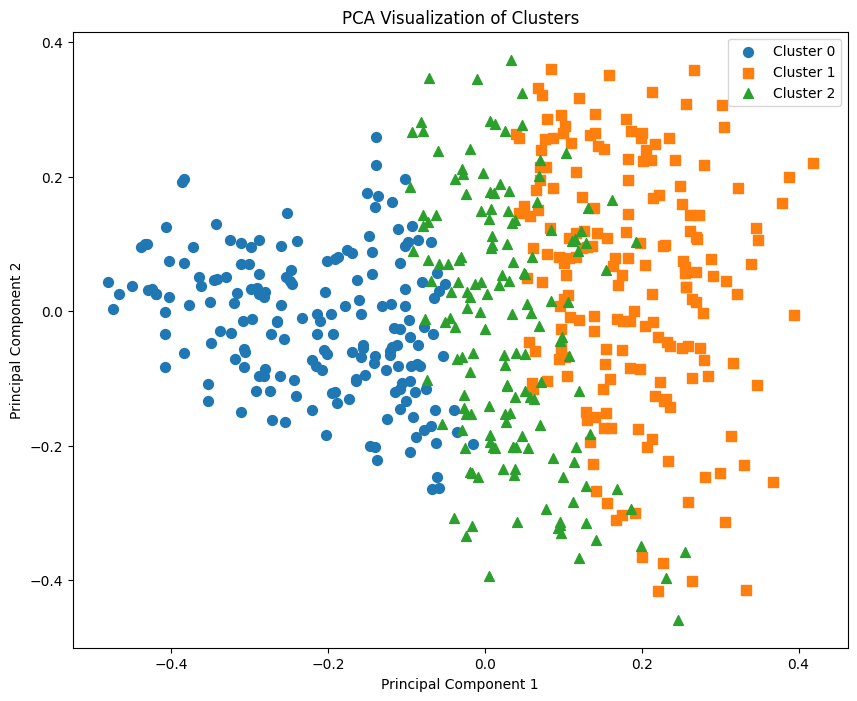

In [9]:
from sklearn.decomposition import PCA

# Reduce embeddings to 2D using PCA
pca = PCA(n_components=2)
reduced_embeddings = pca.fit_transform(all_embeddings)

# Visualize the clusters
plt.figure(figsize=(10, 8))
unique_clusters = np.unique(final_clusters)
markers = ['o', 's', '^', 'D', 'v', 'p', '*', 'h', 'x', 'd']  # Different markers for different clusters

for i, cluster in enumerate(unique_clusters):
    cluster_mask = final_clusters == cluster
    if cluster==3:
        cluster=-1
    plt.scatter(reduced_embeddings[cluster_mask, 0], reduced_embeddings[cluster_mask, 1],
                marker=markers[i % len(markers)], label=f'Cluster {cluster}', s=50)
#scatter = plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], c=final_clusters, cmap='viridis', s=50)
#plt.colorbar(scatter, label="Cluster")
plt.title("PCA Visualization of Clusters")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.legend()
plt.show()

In [ ]:

import os
import pandas as pd

# Assuming `df` is already created and contains columns: "id", "path", "cluster"

train_data = []
val_data = []
test_data = []

# Group by cluster
for cluster, group in df.groupby("cluster"):
    # Shuffle the group
    group = group.sample(frac=1, random_state=42).reset_index(drop=True)
    
    # Calculate split sizes
    total = len(group)
    val_size = min(int(total * 0.1), total // 10)  # Ensure equal representation
    test_size = min(int(total * 0.1), total // 10)  # Ensure equal representation
    train_size = total - test_size - val_size  # Remaining points go to training
    
    # Ensure balanced splits
    val_data.append(group.iloc[:val_size])
    test_data.append(group.iloc[val_size:val_size + test_size])
    train_data.append(group.iloc[val_size + test_size:])
    
# Combine splits into DataFrames
train_df = pd.concat(train_data).reset_index(drop=True)
val_df = pd.concat(val_data).reset_index(drop=True)
test_df = pd.concat(test_data).reset_index(drop=True)

# Print the sizes of each split
print(f"Train set size: {len(train_df)}")
print(f"Validation set size: {len(val_df)}")
print(f"Test set size: {len(test_df)}")

# Save the splits if needed
train_df.to_csv(os.path.join(path_output, "train_split.csv"), index=False)
val_df.to_csv(os.path.join(path_output, "val_split.csv"), index=False)
test_df.to_csv(os.path.join(path_output, "test_split.csv"), index=False)

# Check cluster proportions in each split
train_cluster_counts = train_df['cluster'].value_counts(normalize=True)
val_cluster_counts = val_df['cluster'].value_counts(normalize=True)
test_cluster_counts = test_df['cluster'].value_counts(normalize=True)

print("\nCluster proportions in Train set:")
print(train_cluster_counts) 
print("\nCluster proportions in Validation set:")
print(val_cluster_counts)
print("\nCluster proportions in Test set:")
print(test_cluster_counts)



Train set size: 436
Validation set size: 53
Test set size: 53

Cluster proportions in Train set:
cluster
1    0.405963
0    0.334862
2    0.259174
Name: proportion, dtype: float64

Cluster proportions in Validation set:
cluster
1    0.396226
0    0.339623
2    0.264151
Name: proportion, dtype: float64

Cluster proportions in Test set:
cluster
1    0.396226
0    0.339623
2    0.264151
Name: proportion, dtype: float64


In [10]:
import os
import einops
import torch
import torchaudio
import soundfile as sf
from glob import glob
import tqdm

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

path_TM="/data5/eloi/TencyMastering"
subdirs=["part1","part2", "part3", "part4", "part4_test", "part4_validation"]

path_output="/data5/eloi/TencyMastering/MSCLAP_emb_selected_2"

metadata_file= "/data5/eloi/TencyMastering/simulated_3cluster_dbv_exp.csv"

import pandas as pd

data = []

print("\nNumber of points per cluster:")
for cluster, count in cluster_counts.items():
    print(f"Cluster {cluster}: {count} points")

for k, v in cluster_assignments.items():
    #
    #first find the path of the id
    path_id=None
    for sd in subdirs:
        path=os.path.join(path_TM, sd, k)
        #if directory exists
        if os.path.exists(path):
            path_id=path
    

    assert path_id is not None, f"Path for ID {k} not found in any subdirectory."

    #Add to dataframe
    data.append({"id": k, "path": path_id, "cluster": v})

df= pd.DataFrame(data)


# Assuming `df` is already created and contains columns: "id", "path", "cluster"

# Calculate the total number of points for validation and test sets
total_points = len(df)
val_size = int(total_points * 0.08)
test_size = int(total_points * 0.08)

# Ensure equal number of samples from each cluster
val_size_per_cluster = val_size // 2
test_size_per_cluster = test_size // 2

train_data = []
val_data = []
test_data = []

# Group by cluster
for cluster, group in df.groupby("cluster"):
    # Shuffle the group
    group = group.sample(frac=1, random_state=42).reset_index(drop=True)
    
    # Allocate points equally to validation and test sets
    val_data.append(group.iloc[:val_size_per_cluster])
    test_data.append(group.iloc[val_size_per_cluster:val_size_per_cluster + test_size_per_cluster])
    train_data.append(group.iloc[val_size_per_cluster + test_size_per_cluster:])
    
# Combine splits into DataFrames
train_df = pd.concat(train_data).reset_index(drop=True)
val_df = pd.concat(val_data).reset_index(drop=True)
test_df = pd.concat(test_data).reset_index(drop=True)

# Print the sizes of each split
print(f"Train set size: {len(train_df)}")
print(f"Validation set size: {len(val_df)}")
print(f"Test set size: {len(test_df)}")

# Save the splits if needed
train_df.to_csv(os.path.join(path_output, "train_split.csv"), index=False)
val_df.to_csv(os.path.join(path_output, "val_split.csv"), index=False)
test_df.to_csv(os.path.join(path_output, "test_split.csv"), index=False)

# Check cluster proportions in each split
train_cluster_counts = train_df['cluster'].value_counts(normalize=True)
val_cluster_counts = val_df['cluster'].value_counts(normalize=True)
test_cluster_counts = test_df['cluster'].value_counts(normalize=True)

print("\nCluster proportions in Train set:")
print(train_cluster_counts) 
print("\nCluster proportions in Validation set:")
print(val_cluster_counts)
print("\nCluster proportions in Test set:")
print(test_cluster_counts)



Number of points per cluster:
Cluster 0: 182 points
Cluster 1: 185 points
Cluster 2: 158 points
Train set size: 399
Validation set size: 63
Test set size: 63

Cluster proportions in Train set:
cluster
1    0.358396
0    0.350877
2    0.290727
Name: proportion, dtype: float64

Cluster proportions in Validation set:
cluster
0    0.333333
1    0.333333
2    0.333333
Name: proportion, dtype: float64

Cluster proportions in Test set:
cluster
0    0.333333
1    0.333333
2    0.333333
Name: proportion, dtype: float64


In [27]:
total_points

542

In [21]:
#let's listen to some examples from each cluster
import soundfile as sf
import random
import pandas as pd
import os
path_output="/data5/eloi/TencyMastering/MSCLAP_emb_selected"

mix_filenames= ["nbv-bv-ld-nomasterfx_dry.wav","nbv-bv-ld-nomaster-fx_dry.wav", "nbv-lv-nomasterfx_dry.wav", "nbv-bv-ld-NoMasterFx_dry.wav", "nbv-ld-nomasterfx_dry.wav", "nbv-ld-NoMasterFx_dry.wav","nbv-bv-nomasterfx_dry.wav", "nbv-nomasterfx_dry.wav"]

filename= os.path.join(path_output, "test_split.csv")
df_i= pd.read_csv(filename)

cluster_to_listen = 0  # Change this to the cluster you want to listen to

# Get the paths of the files in the specified cluster
cluster_files = df_i[df_i['cluster'] == cluster_to_listen]['path'].tolist()
index=12
path_mix=os.path.join(cluster_files[index], "mix")

for filename in mix_filenames:
        if os.path.exists(os.path.join(path_mix, filename)):
            mix_file = os.path.join(path_mix, filename)
            break
print(f"Listening to {mix_file} from cluster {cluster_to_listen}")

x, sr = sf.read(mix_file, dtype='float32')
x=x.T

import IPython.display as ipd

ipd.display(ipd.Audio(x, rate=sr))





Listening to /data5/eloi/TencyMastering/part2/67105/mix/nbv-ld-nomasterfx_dry.wav from cluster 0


In [ ]:
# CLuster 0: Metal Rock country
# Cluster 1: country/folk
# Cluster 2:  Pop/Dance


#cluster 0: pop  
#cluster 1: country rock




In [23]:

import plotly.express as px
import pandas as pd
from sklearn.decomposition import PCA

# Reduce embeddings to 2D using PCA
pca = PCA(n_components=2)
reduced_embeddings = pca.fit_transform(all_embeddings)

# Create a DataFrame for Plotly
plot_data = pd.DataFrame({
    'id': df['id'],  # Assuming `df` contains the IDs
    'cluster': final_clusters,
    'pc1': reduced_embeddings[:, 0],  # Principal Component 1
    'pc2': reduced_embeddings[:, 1]   # Principal Component 2
})

# Replace cluster label 3 with -1 if needed
plot_data['cluster'] = plot_data['cluster'].replace(3, -1)

# Create an interactive scatter plot
fig = px.scatter(
    plot_data,
    x='pc1',
    y='pc2',
    color='cluster',
    hover_data=['id'],  # Show `id` when hovering over points
    title="PCA Visualization of Clusters",
    labels={'pc1': 'Principal Component 1', 'pc2': 'Principal Component 2'}
)

# Show the plot
fig.show()

ValueError: array length 542 does not match index length 63

In [26]:
df

,id,path,cluster
0,22639,/data5/eloi/TencyMastering/part1/22639,0
1,67392,/data5/eloi/TencyMastering/part2/67392,0
2,66246,/data5/eloi/TencyMastering/part3/66246,0
3,11446,/data5/eloi/TencyMastering/part1/11446,0
4,45403,/data5/eloi/TencyMastering/part1/45403,0
...,...,...,...
58,44020,/data5/eloi/TencyMastering/part1/44020,2
59,67867,/data5/eloi/TencyMastering/part2/67867,2
60,67735,/data5/eloi/TencyMastering/part4_validation/67735,2
61,44631,/data5/eloi/TencyMastering/part1/44631,2


In [ ]:
import pandas as pd
path_train_df="/data5/eloi/TencyMastering/CLAP_emb_selected/train_split.csv"